# Run models on Test Images
This notebook will run this project on the images located in the "TestingImages" folder. This project will detect and classify traffic signs in the images, and output the images with the traffic sign classifications on them.

In [14]:
import sys
!{sys.executable} -m pip install numpy 

# Imports

In [8]:
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import os
import tensorflow as tf
from matplotlib import pyplot as plt
from PIL import Image
import glob as glob
import sys
from keras.models import load_model
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

# Environment setup

In [10]:
%matplotlib inline


projectPath = '/home/nightlinux/Project/' # Change to location of github project 

classifyModelPath = os.path.join(projectPath, 'ClassificationModel')
classifyModel = None # Has to be loaded later

#dictionary to label all traffic signs class.
classifyClasses = { 1:'Speed limit (20km/h)', 2:'Speed limit (30km/h)', 3:'Speed limit (50km/h)',       
            4:'Speed limit (60km/h)', 5:'Speed limit (70km/h)', 6:'Speed limit (80km/h)',
            7:'End of speed limit (80km/h)', 8:'Speed limit (100km/h)', 9:'Speed limit (120km/h)',     
           10:'No passing', 11:'No passing veh over 3.5 tons', 12:'Right-of-way at intersection',     
           13:'Priority road', 14:'Yield', 15:'Stop', 16:'No vehicles', 17:'Veh > 3.5 tons prohibited',       
           18:'No entry', 19:'General caution', 20:'Dangerous curve left', 21:'Dangerous curve right',   
           22:'Double curve', 23:'Bumpy road', 24:'Slippery road', 25:'Road narrows on the right',  
           26:'Road work', 27:'Traffic signals', 28:'Pedestrians', 29:'Children crossing',     
           30:'Bicycles crossing', 31:'Beware of ice/snow', 32:'Wild animals crossing',      
           33:'End speed + passing limits', 34:'Turn right ahead', 35:'Turn left ahead',       
           36:'Ahead only', 37:'Go straight or right', 38:'Go straight or left',      
           39:'Keep right', 40:'Keep left', 41:'Roundabout mandatory', 42:'End of no passing',      
           43:'End no passing veh > 3.5 tons' }

# Path to frozen detection graph. This is the actual model that is used for the traffic sign detection.
detectionModelPath = os.path.join(projectPath, 'DetectionModel')
ckptPath = os.path.join(detectionModelPath,'inference_graph/frozen_inference_graph.pb')

# List of the strings that is used to add correct label for each box.
labelPath = os.path.join(projectPath + "ClassificationDataset", 'Labels.txt')

numClasses = 43

labelMap = label_map_util.load_labelmap(labelPath)
categories = label_map_util.convert_label_map_to_categories(labelMap, max_num_classes=numClasses, use_display_name=True)
categoryIndex = label_map_util.create_category_index(categories)


# For the sake of simplicity we will use only 2 images:
# image1.jpg
# image2.jpg
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
testImagePath = os.path.join(projectPath, 'TestingImages')
testImages = glob.glob(os.path.join(testImagePath, '*')) # Anything in the TestingImages will be considered an image!

# Size, in inches, of the output images for PLT.
imageSize = (20, 20)

## Load the detection model into memory (Expensive!!)

In [11]:
detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.compat.v1.GraphDef() # CHANGED FOR NEW TENSORFLOW SYNTAX
    with tf.compat.v2.io.gfile.GFile(ckptPath, 'rb') as fid: # CHANGED SEE ABOVE
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')

## Helper code

In [12]:
def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape((im_height, im_width, 3)).astype(np.uint8)

def changeClassificationResults(image,boxes,scores):
    global boxesDetected
    # First, grab all bounding boxes for the image
    boxes = np.squeeze(boxes)
    max_boxes_to_draw = boxes.shape[0]
    scores = np.squeeze(scores)
    
    # We need a minimum score to rule out bounding boxes that won't be shown in the image
    # Mainly, bounding boxes that have less than 0.5 confidence in being a traffic sign box
    min_score_thresh=.5
    ids = np.squeeze(classes).astype(np.int32)
    
    for i in range(min(max_boxes_to_draw, boxes.shape[0])):
        if scores is None or scores[i] > min_score_thresh:
            # We don't want the original ID from the detection model, as it only has 3 classes.
            # Change ID of box to be the result of our classification model instead.
            class_name = categoryIndex[np.squeeze(classes).astype(np.int32)[i]]['name']
            ids[i] = classifySignInImage(image,boxes[i])
            
    return ids 

def classifySignInImage(pimage, boundingBox):
    # Use our classify model to classify a traffic sign
    (im_width, im_height) = pimage.size

    #LowY, LowX, HighY, HighX
    LowY = boundingBox[0] * im_height
    LowX = boundingBox[1] * im_width
    HighY = boundingBox[2] * im_height
    HighX = boundingBox[3] * im_width

    pimage = pimage.crop([LowX,LowY,HighX,HighY]) # Crop image to just what's in the bounding box
    pimage = pimage.resize((30,30))

    pimage = np.expand_dims(pimage, axis=0) # Expand dimensions to satisfy model's input layer
    pimage = np.array(pimage)
    pred = classifyModel.predict_classes([pimage])[0]
    sign = classifyClasses[pred+1]
    return pred + 1

## Detection

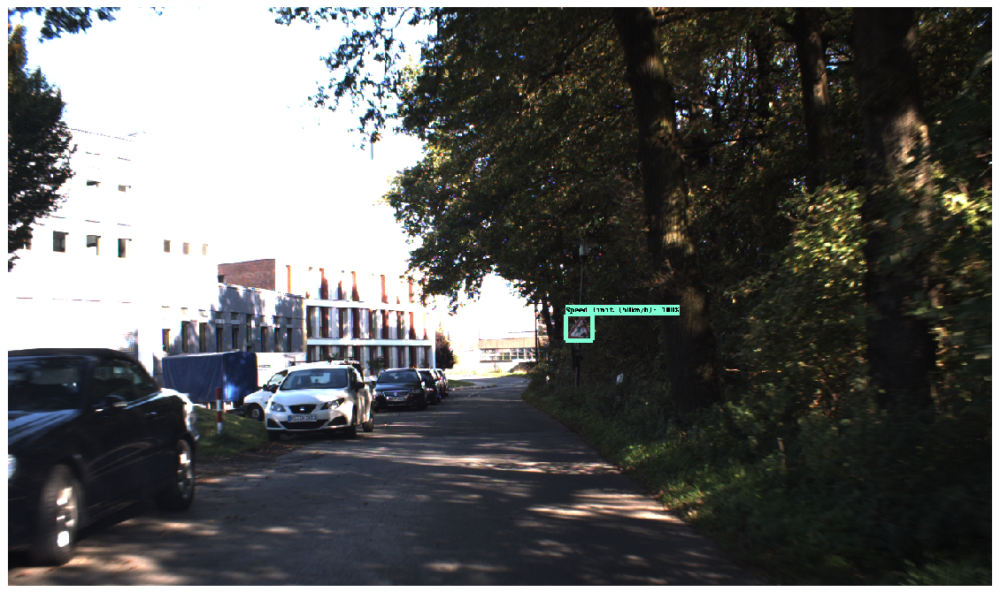

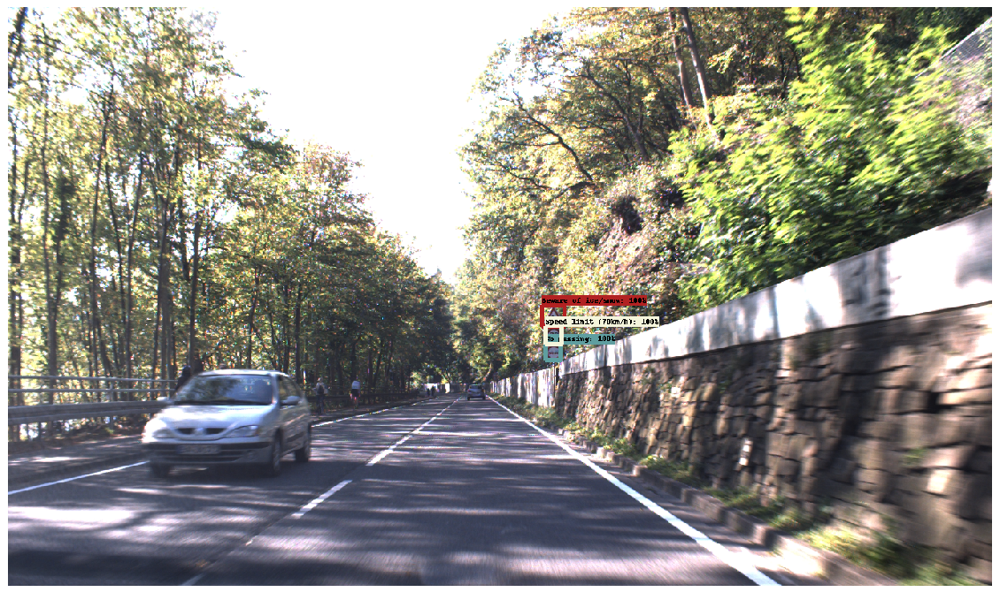

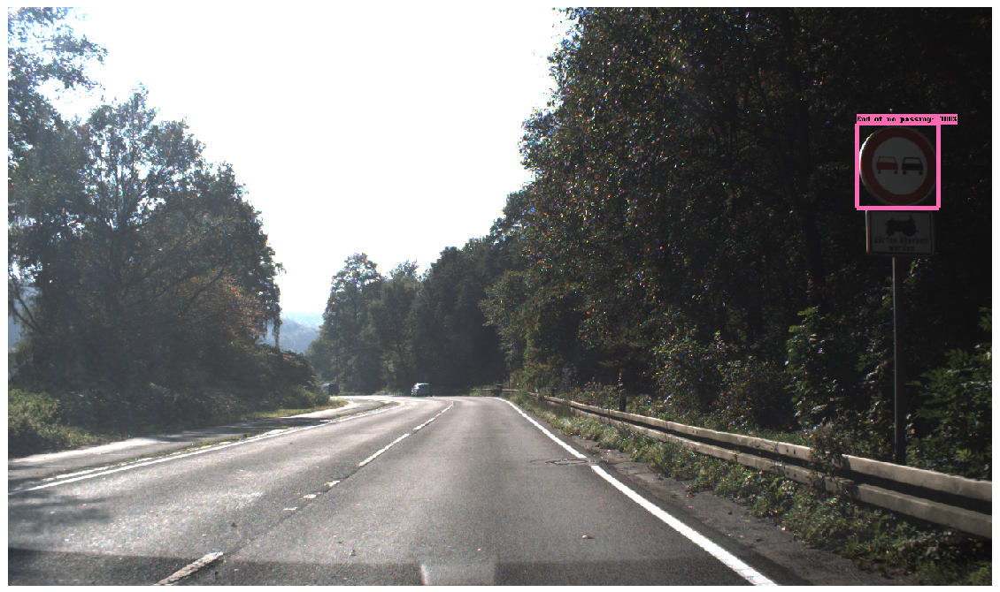

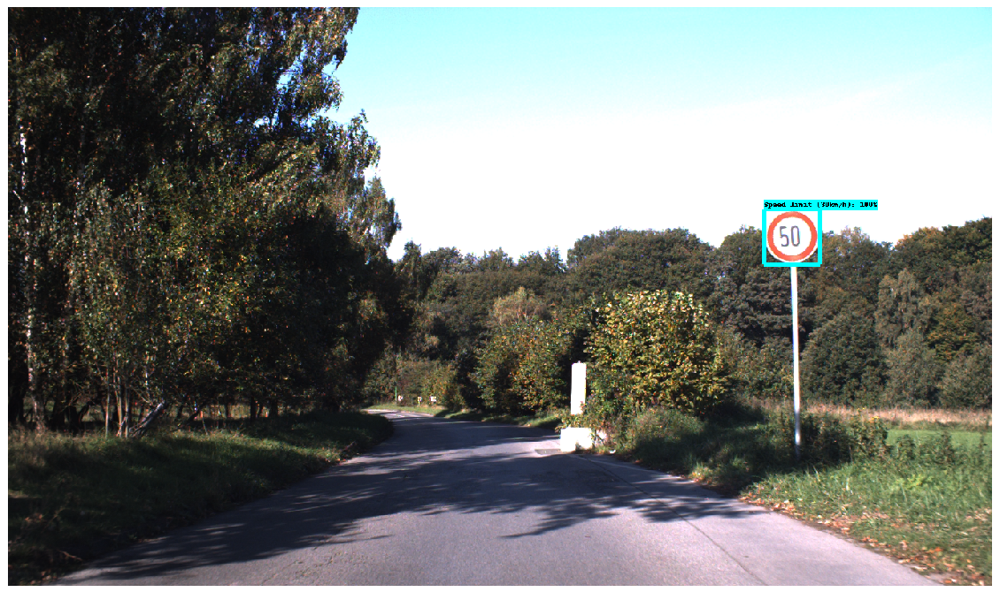

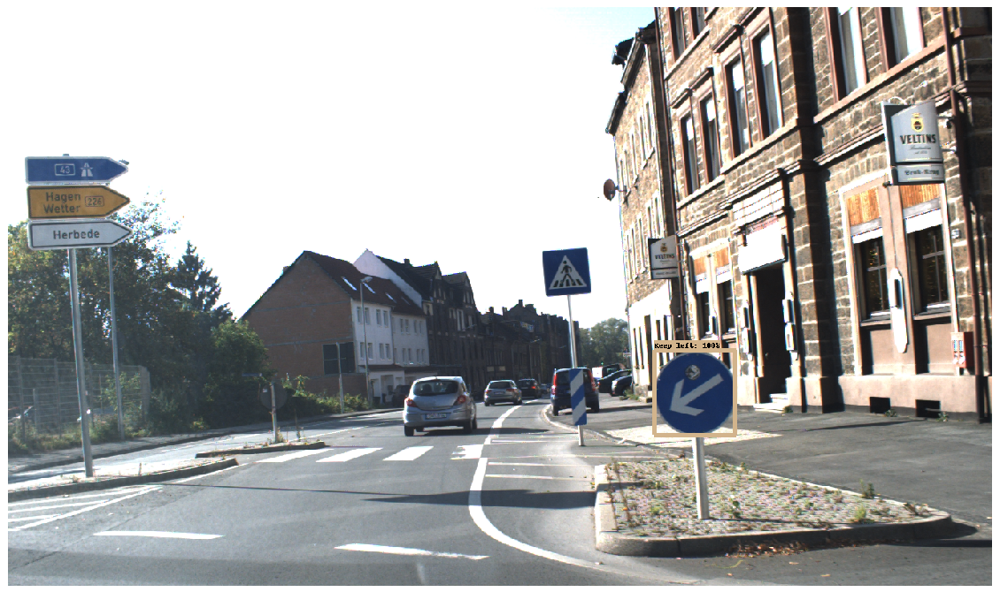

...

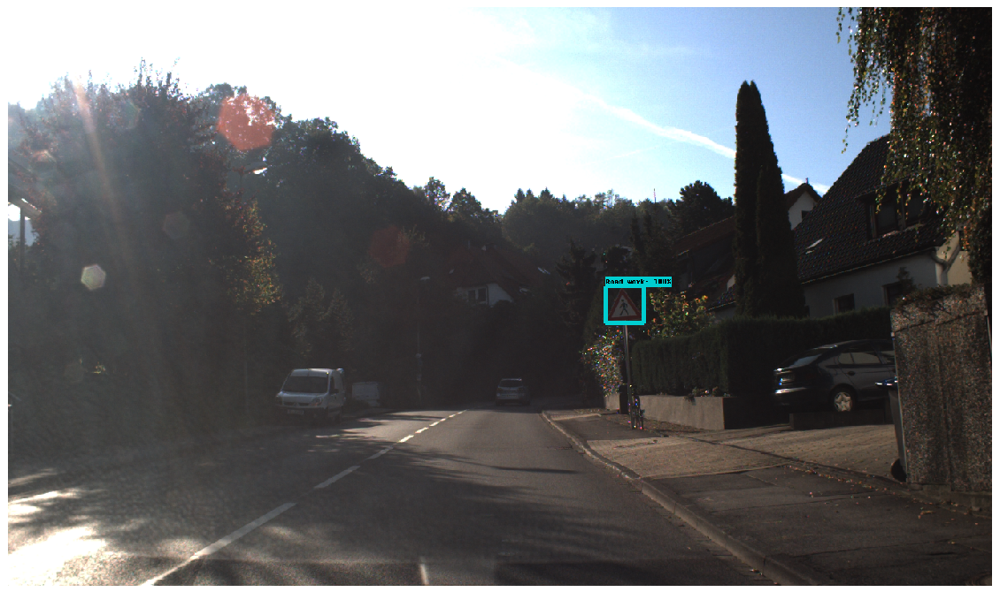

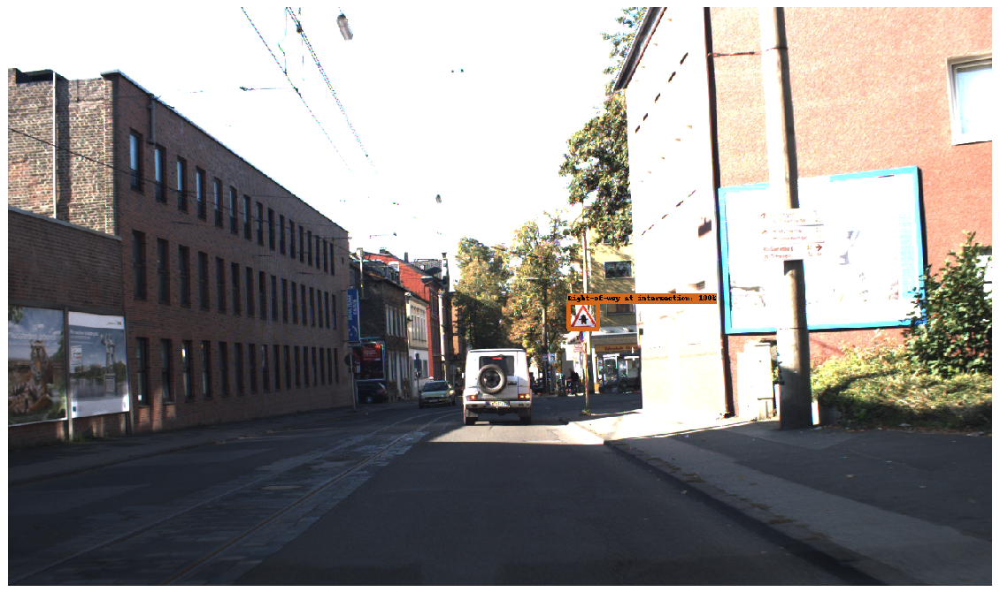

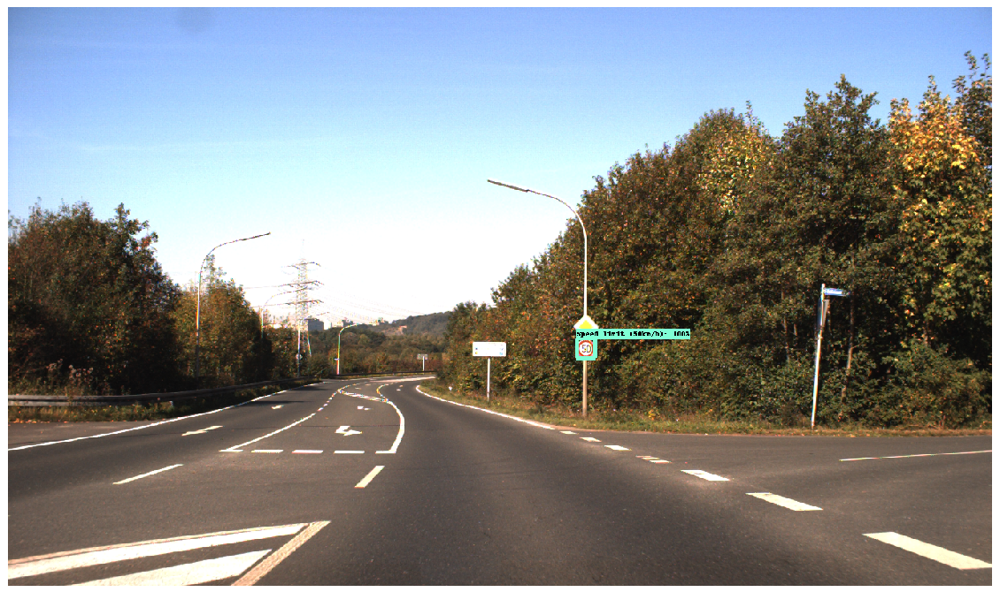

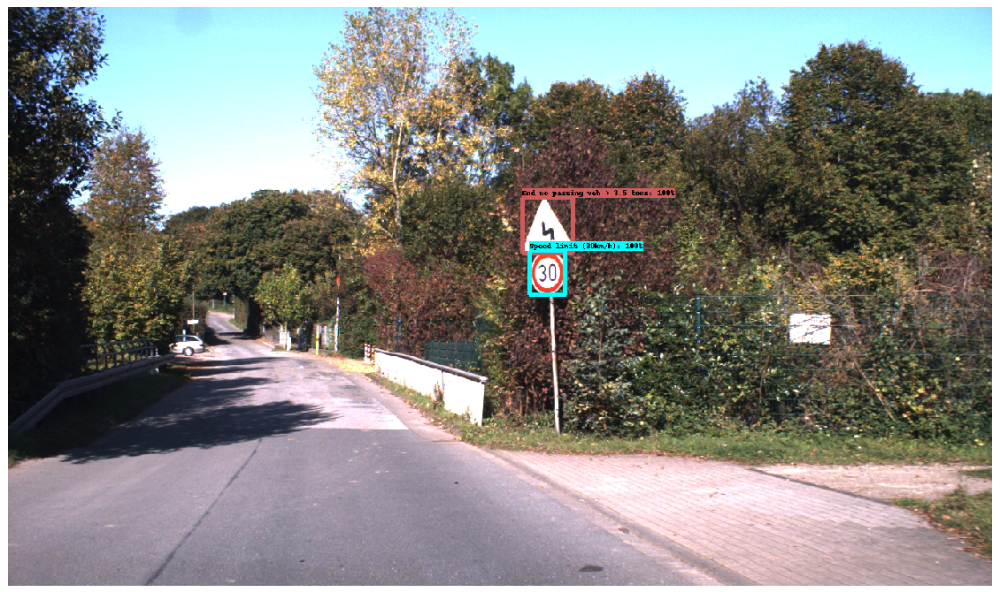

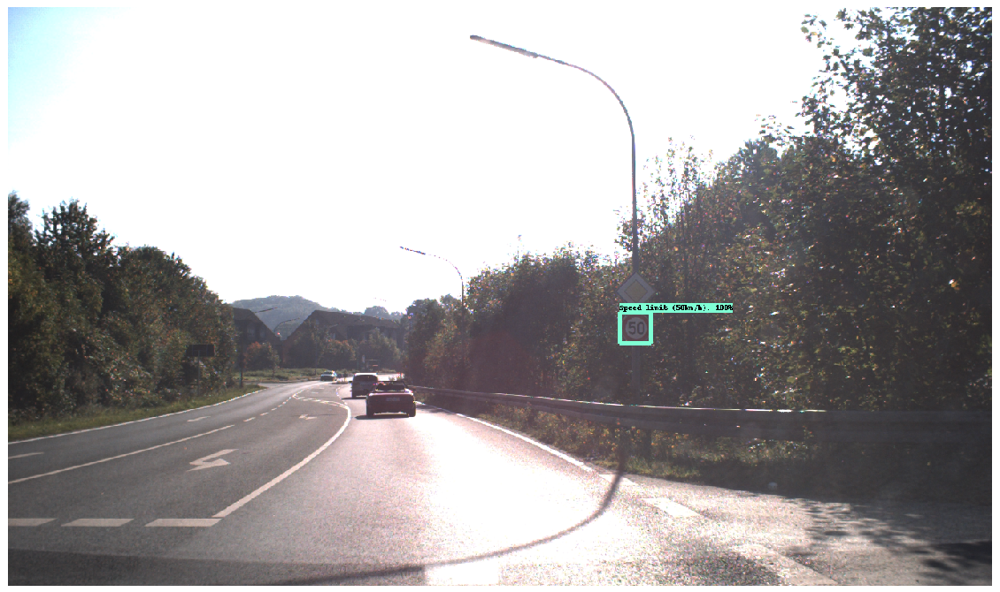

In [13]:
with detection_graph.as_default():
    with tf.compat.v1.Session(graph=detection_graph) as sess: # Was originally tf.Session
        classifyModel = load_model(os.path.join(classifyModelPath,'my_model.h5'))
        for idx, image_path in enumerate(testImages):
            image = Image.open(image_path)
            image_np = load_image_into_numpy_array(image)
            # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
            image_np_expanded = np.expand_dims(image_np, axis=0)
            image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
            # Each box represents a part of the image where a particular object was detected.
            boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
            
            # Each score represent how level of confidence for each of the objects.
            # Score is shown on the result image, together with the class label.
            scores = detection_graph.get_tensor_by_name('detection_scores:0')
            classes = detection_graph.get_tensor_by_name('detection_classes:0')
            num_detections = detection_graph.get_tensor_by_name('num_detections:0')
            # Actual detection.
            (boxes, scores, classes, num_detections) = sess.run(
                [boxes, scores, classes, num_detections],
                feed_dict={image_tensor: image_np_expanded})

            # Visualization of the results of a detection.
            vis_util.visualize_boxes_and_labels_on_image_array(
                image_np,
                np.squeeze(boxes),
                changeClassificationResults(image,boxes,scores),
                np.squeeze(scores),
                categoryIndex,
                use_normalized_coordinates=True,
                line_thickness=6)

            plt.figure(idx, figsize=imageSize)
            plt.axis('off')
            plt.imshow(image_np)